# Understanding K-means with visuals

**We will explore how different values of k affect the clustering of the pixels, and thus the appearance of the photograph**

In [1]:
from sklearn.cluster import KMeans
import plotly.graph_objects as go
import pandas as pd
import numpy as np
%pylab inline


import warnings

# Ignore FutureWarnings related to scikit-learn's KMeans
warnings.filterwarnings("ignore", category=FutureWarning)


Populating the interactive namespace from numpy and matplotlib


In [2]:
img = plt.imread(r'C:\Users\ASUS\Downloads\flowr.jpg')

(600, 600, 3)


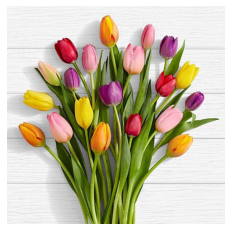

In [3]:
# Display the photo and its shape
print(img.shape)
plt.imshow(img)
plt.axis('off');

In [4]:
img_1 = img.reshape(img.shape[0]*img.shape[1], 3)

In [5]:
# Create a pandas df with r, g, and b as columns
img_2 = pd.DataFrame(img_1, columns = ['r', 'g', 'b'])
img_2.head()

,r,g,b
0,244,244,244
1,244,244,244
2,244,244,244
3,244,244,244
4,245,245,245


In [6]:
# Create 3D plot where each pixel in the `img` is displayed in its actual color
trace = go.Scatter3d(x = img_2.r,
                     y = img_2.g,
                     z = img_2.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for r,g,b 
                                        in zip(img_2.r.values, 
                                               img_2.g.values, 
                                               img_2.b.values)],
                                 opacity=0.5))

data = [trace]

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0),
                               )

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )
fig.show()

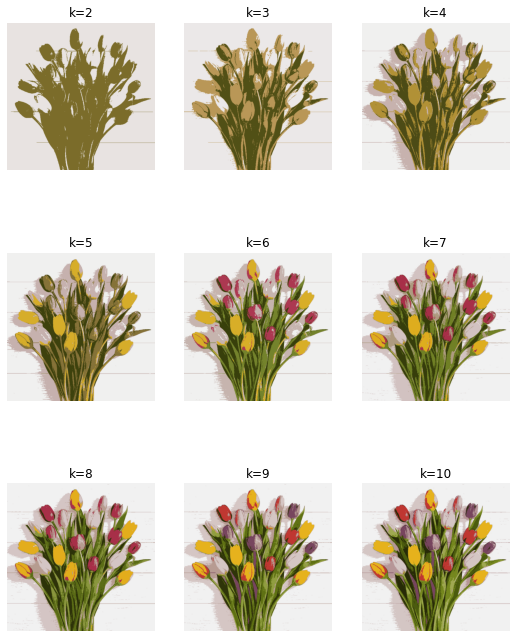

In [7]:
# Helper function to plot image grid
def cluster_image_grid(k, ax, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image on an axis of a figure.

    Args:
      k:    (int)          - Your selected K-value
      ax:   (int)          - Index of the axis of the figure to plot to
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      A new image where each row of img's array has been replaced with the \ 
      coordinates of its nearest centroid. Image is assigned to an axis that \
      can be used in an image grid figure.
    '''
    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters=k, random_state=42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_==i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)
    ax.imshow(new_img)
    ax.axis('off')

fig, axs = plt.subplots(3, 3)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 12)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=img)
    axs[i].title.set_text('k=' + str(k))

**Hopefully, this demonstration has deepened your understanding of how the K-means algorithm works.** 